This code will show you which torsion angles changed and by how much. It provides three ways to confirm the changes:

Printing and comparing the phi/psi angles of the original and modified poses.
Directly calculating and displaying the changes in torsion angles.
Dumping PDB files for visualization in PyMOL.

In [40]:
# Cell 1: Import necessary modules and initialize PyRosetta
import pyrosetta
from pyrosetta import pose_from_pdb
from pyrosetta.rosetta.protocols.simple_moves import SmallMover
from pyrosetta.rosetta.core.kinematics import MoveMap
from pyrosetta.rosetta.protocols.minimization_packing import MinMover
from pyrosetta.rosetta.core.scoring import get_score_function
import logging
import random

# Set up logging
logging.basicConfig(level=logging.INFO)
logger = logging.getLogger(__name__)

# Initialize PyRosetta
pyrosetta.init()


INFO:pyrosetta.rosetta:Found rosetta database at: /opt/anaconda3/envs/rosetta/lib/python3.9/site-packages/pyrosetta-2024.24+release.ca096dac4f-py3.9-macosx-11.0-arm64.egg/pyrosetta/database; using it....
INFO:pyrosetta.rosetta:┌──────────────────────────────────────────────────────────────────────────────┐
│                                 PyRosetta-4                                  │
│              Created in JHU by Sergey Lyskov and PyRosetta Team              │
│              (C) Copyright Rosetta Commons Member Institutions               │
│                                                                              │
│ NOTE: USE OF PyRosetta FOR COMMERCIAL PURPOSES REQUIRE PURCHASE OF A LICENSE │
│         See LICENSE.PyRosetta.md or email license@uw.edu for details         │
└──────────────────────────────────────────────────────────────────────────────┘
PyRosetta-4 2024 [Rosetta PyRosetta4.Release.python39.m1 2024.24+release.ca096dac4f43ee5ee195f87f3703a520fcf60cf9 2024-06-14T

┌──────────────────────────────────────────────────────────────────────────────┐
│                                 PyRosetta-4                                  │
│              Created in JHU by Sergey Lyskov and PyRosetta Team              │
│              (C) Copyright Rosetta Commons Member Institutions               │
│                                                                              │
│ NOTE: USE OF PyRosetta FOR COMMERCIAL PURPOSES REQUIRE PURCHASE OF A LICENSE │
│         See LICENSE.PyRosetta.md or email license@uw.edu for details         │
└──────────────────────────────────────────────────────────────────────────────┘
PyRosetta-4 2024 [Rosetta PyRosetta4.Release.python39.m1 2024.24+release.ca096dac4f43ee5ee195f87f3703a520fcf60cf9 2024-06-14T16:57:57] retrieved from: http://www.pyrosetta.org


In [41]:
# Cell 2: Load the pose and analyze its contents
pdb_path = "./pdb_files/5a4d.pdb"
pose = pose_from_pdb(pdb_path)
logger.info(f"Pose loaded successfully from {pdb_path}")
logger.info(f"Total residues in pose: {pose.total_residue()}")

# Identify protein residues
protein_residues = [i for i in range(1, pose.total_residue() + 1) if pose.residue(i).is_protein()]
logger.info(f"Number of protein residues: {len(protein_residues)}")


INFO:rosetta:core.import_pose.import_pose: File './pdb_files/5a4d.pdb' automatically determined to be of type PDB
INFO:rosetta:core.conformation.Conformation: [ WARNING ] missing heavyatom:  CG  on residue LYS 2
INFO:rosetta:core.conformation.Conformation: [ WARNING ] missing heavyatom:  CD  on residue LYS 2
INFO:rosetta:core.conformation.Conformation: [ WARNING ] missing heavyatom:  CE  on residue LYS 2
INFO:rosetta:core.conformation.Conformation: [ WARNING ] missing heavyatom:  NZ  on residue LYS 2
INFO:rosetta:core.conformation.Conformation: [ WARNING ] missing heavyatom:  CG  on residue LYS 154
INFO:rosetta:core.conformation.Conformation: [ WARNING ] missing heavyatom:  CD  on residue LYS 154
INFO:rosetta:core.conformation.Conformation: [ WARNING ] missing heavyatom:  CE  on residue LYS 154
INFO:rosetta:core.conformation.Conformation: [ WARNING ] missing heavyatom:  NZ  on residue LYS 154
INFO:rosetta:core.conformation.Conformation: [ WARNING ] missing heavyatom:  OXT on residue PR

In [42]:
# Cell 3: Function to print phi/psi angles for protein residues
def print_phi_psi(pose, residues):
    logger.info("Residue\tPhi\tPsi")
    for i in residues:
        try:
            phi = pose.phi(i)
            psi = pose.psi(i)
            logger.info(f"{i}\t{phi:.2f}\t{psi:.2f}")
        except Exception as e:
            logger.error(f"Error getting phi/psi for residue {i}: {e}")


In [43]:
# Cell 4: Set up MoveMap, SmallMover, and MinMover
movemap = MoveMap()
for i in protein_residues:
    movemap.set_bb(i, True)

smallmover = SmallMover(movemap, 1.0, 20)  # Increased to 20 moves
smallmover.angle_max('H', 60)  # Increased to 60 degrees
smallmover.angle_max('E', 60)
smallmover.angle_max('L', 60)

# Set up MinMover
sf = get_score_function()
minmover = MinMover()
minmover.movemap(movemap)
minmover.score_function(sf)

logger.info("MoveMap, SmallMover, and MinMover set up for protein residues")



INFO:rosetta:core.scoring.ScoreFunctionFactory: SCOREFUNCTION: ref2015
INFO:__main__:MoveMap, SmallMover, and MinMover set up for protein residues


In [44]:
# Cell 5: Apply movers and compare phi/psi angles
test_pose = pose.clone()
sample_residues = random.sample(protein_residues, min(50, len(protein_residues)))

logger.info("Phi/psi angles before applying movers (50 random protein residues):")
print_phi_psi(pose, sample_residues)

logger.info("Applying SmallMover...")
smallmover.apply(test_pose)

logger.info("Applying MinMover...")
minmover.apply(test_pose)

logger.info("Phi/psi angles after applying movers (same 50 random protein residues):")
print_phi_psi(test_pose, sample_residues)


INFO:__main__:Phi/psi angles before applying movers (50 random protein residues):
INFO:__main__:Residue	Phi	Psi
INFO:__main__:381	-113.66	14.95
INFO:__main__:1831	-71.70	155.54
INFO:__main__:2532	-71.11	127.97
INFO:__main__:1981	-66.41	146.68
INFO:__main__:2020	-96.14	108.46
INFO:__main__:531	-84.06	-24.29
INFO:__main__:1779	-59.58	148.72
INFO:__main__:640	-62.10	-54.05
INFO:__main__:1162	-85.92	115.97
INFO:__main__:2360	-117.19	159.03
INFO:__main__:1039	-96.89	20.26
INFO:__main__:2254	-163.77	161.09
INFO:__main__:1044	-157.33	149.94
INFO:__main__:1949	-122.30	133.78
INFO:__main__:505	-105.51	155.74
INFO:__main__:714	-70.73	-40.43
INFO:__main__:1007	-60.43	137.44
INFO:__main__:286	-61.04	-35.12
INFO:__main__:2573	-80.67	3.71
INFO:__main__:17	-61.40	-38.64
INFO:__main__:2221	-72.85	-44.25
INFO:__main__:2307	-60.92	136.98
INFO:__main__:498	-66.05	-47.31
INFO:__main__:1833	-71.09	-38.14
INFO:__main__:2339	-96.85	22.88
INFO:__main__:1970	-67.79	-26.99
INFO:__main__:340	-76.54	-19.53
INFO:_

In [45]:
# Cell 6: Compare changes in phi/psi angles
logger.info("Changes in phi/psi angles (50 random protein residues):")
logger.info("Residue\tDelta Phi\tDelta Psi")
changes_detected = False
for i in sample_residues:
    delta_phi = test_pose.phi(i) - pose.phi(i)
    delta_psi = test_pose.psi(i) - pose.psi(i)
    logger.info(f"{i}\t{delta_phi:.2f}\t{delta_psi:.2f}")
    if abs(delta_phi) > 0.001 or abs(delta_psi) > 0.001:
        changes_detected = True

if not changes_detected:
    logger.warning("No changes detected in phi/psi angles. This is unexpected.")
    logger.info("Debugging information:")
    movable_residues = [i for i in range(1, pose.total_residue()+1) if movemap.get_bb(i)]
    logger.info(f"Number of movable residues: {len(movable_residues)}")
    logger.info(f"First 10 movable residues: {movable_residues[:10]}")
    logger.info(f"SmallMover number of moves: {smallmover.nmoves()}")


INFO:__main__:Changes in phi/psi angles (50 random protein residues):
INFO:__main__:Residue	Delta Phi	Delta Psi
INFO:__main__:381	11.68	4.49
INFO:__main__:1831	-31.82	-5.53
INFO:__main__:2532	-7.20	16.86
INFO:__main__:1981	-1.68	2.18
INFO:__main__:2020	12.23	15.04
INFO:__main__:531	10.82	9.95
INFO:__main__:1779	-16.38	10.02
INFO:__main__:640	2.89	10.52
INFO:__main__:1162	5.38	13.01
INFO:__main__:2360	2.55	-19.43
INFO:__main__:1039	-2.92	-0.23
INFO:__main__:2254	6.14	-4.03
INFO:__main__:1044	6.89	-10.96
INFO:__main__:1949	8.20	-1.67
INFO:__main__:505	16.22	7.51
INFO:__main__:714	-10.06	13.53
INFO:__main__:1007	0.43	11.48
INFO:__main__:286	-5.08	-1.76
INFO:__main__:2573	0.13	-3.24
INFO:__main__:17	0.74	5.18
INFO:__main__:2221	11.63	-2.73
INFO:__main__:2307	2.46	5.82
INFO:__main__:498	-7.00	4.03
INFO:__main__:1833	-5.15	3.61
INFO:__main__:2339	-3.01	-2.91
INFO:__main__:1970	4.83	3.52
INFO:__main__:340	-6.24	15.65
INFO:__main__:2426	-41.03	-6.20
INFO:__main__:1843	2.17	13.99
INFO:__main__:

In [46]:
# Cell 7: Check for constraints
if not changes_detected:
    logger.info("Checking for constraints...")
    constraints = pose.constraint_set()
    if constraints.empty():
        logger.info("No constraints found in the pose.")
    else:
        logger.info("Constraints found in the pose. This might prevent movement.")
        
    # Try to remove constraints and apply movers again
    logger.info("Attempting to remove constraints and apply movers again...")
    test_pose_no_constraints = pose.clone()
    test_pose_no_constraints.remove_constraints()
    smallmover.apply(test_pose_no_constraints)
    minmover.apply(test_pose_no_constraints)
    
    changes_detected_no_constraints = False
    for i in sample_residues:
        delta_phi = test_pose_no_constraints.phi(i) - pose.phi(i)
        delta_psi = test_pose_no_constraints.psi(i) - pose.psi(i)
        if abs(delta_phi) > 0.001 or abs(delta_psi) > 0.001:
            changes_detected_no_constraints = True
            break
    
    if changes_detected_no_constraints:
        logger.info("Changes detected after removing constraints.")
    else:
        logger.info("No changes detected even after removing constraints.")

In [47]:
# Cell 8: Manual torsion angle adjustment
if not changes_detected and not changes_detected_no_constraints:
    logger.info("Attempting manual torsion angle adjustment...")
    manual_test_pose = pose.clone()
    for i in protein_residues[:10]:  # Try first 10 protein residues
        original_phi = manual_test_pose.phi(i)
        try:
            manual_test_pose.set_phi(i, original_phi + 5)  # Add 5 degrees to phi
            new_phi = manual_test_pose.phi(i)
            logger.info(f"Residue {i}: Original Phi = {original_phi:.2f}, New Phi = {new_phi:.2f}")
            if abs(new_phi - original_phi) > 0.001:
                logger.info(f"Manual adjustment successful for residue {i}")
                break
        except Exception as e:
            logger.error(f"Error adjusting phi angle for residue {i}: {e}")
    else:
        logger.error("Unable to manually adjust torsion angles. The pose might be constrained or there could be an issue with the PDB file.")


In [48]:
# Cell 9: Final analysis
if not changes_detected and not changes_detected_no_constraints:
    logger.error("All attempts to modify the pose have failed. Possible reasons:")
    logger.error("1. The PDB file might have special features preventing movement.")
    logger.error("2. There might be an issue with the PyRosetta installation.")
    logger.error("3. The pose might be in a highly optimized state where small moves are rejected.")
    logger.error("Please consider the following steps:")
    logger.error("- Check the PDB file for any unusual features or annotations.")
    logger.error("- Verify your PyRosetta installation and try with a different PDB file.")
    logger.error("- Consider using more aggressive movers or custom scripts to modify the pose.")

In [51]:
# Cell 10: Analyze results

import numpy as np

# Analyze changes in phi/psi angles
phi_changes = []
psi_changes = []
residues = []

for i in sample_residues:
    original_phi = pose.phi(i)
    original_psi = pose.psi(i)
    new_phi = test_pose.phi(i)
    new_psi = test_pose.psi(i)
    
    delta_phi = new_phi - original_phi
    delta_psi = new_psi - original_psi
    
    phi_changes.append(delta_phi)
    psi_changes.append(delta_psi)
    residues.append(i)

logger.info("Analysis of phi/psi angle changes:")
logger.info(f"Mean absolute phi change: {np.mean(np.abs(phi_changes)):.2f} degrees")
logger.info(f"Mean absolute psi change: {np.mean(np.abs(psi_changes)):.2f} degrees")
logger.info(f"Max absolute phi change: {np.max(np.abs(phi_changes)):.2f} degrees")
logger.info(f"Max absolute psi change: {np.max(np.abs(psi_changes)):.2f} degrees")

# Identify residues with largest changes
largest_phi_change_index = np.argmax(np.abs(phi_changes))
largest_psi_change_index = np.argmax(np.abs(psi_changes))

logger.info(f"Residue with largest phi change: {residues[largest_phi_change_index]}")
logger.info(f"Residue with largest psi change: {residues[largest_psi_change_index]}")

logger.info("\nDetails of largest changes:")
logger.info(f"Largest phi change: {phi_changes[largest_phi_change_index]:.2f} degrees at residue {residues[largest_phi_change_index]}")
logger.info(f"Largest psi change: {psi_changes[largest_psi_change_index]:.2f} degrees at residue {residues[largest_psi_change_index]}")

logger.info("\nConclusion:")
logger.info("The SmallMover and MinMover have successfully modified the pose.")
logger.info("The changes in phi/psi angles are significant and within expected ranges.")

logger.info("\nNext steps:")
logger.info("1. Visualize the changes using PyMOL or a similar tool to ensure they are reasonable.")
logger.info("2. If needed, adjust the SmallMover and MinMover parameters to achieve desired levels of change.")
logger.info("3. Proceed with your intended analysis or modification of the structure.")
logger.info("4. Consider using this modified pose as a starting point for further calculations or simulations.")

# Cell 11: Save modified pose
output_pdb_path = "modified_5a4d.pdb"
test_pose.dump_pdb(output_pdb_path)
logger.info(f"\nModified pose saved to: {output_pdb_path}")

INFO:__main__:Analysis of phi/psi angle changes:
INFO:__main__:Mean absolute phi change: 9.16 degrees
INFO:__main__:Mean absolute psi change: 8.27 degrees
INFO:__main__:Max absolute phi change: 41.03 degrees
INFO:__main__:Max absolute psi change: 31.23 degrees
INFO:__main__:Residue with largest phi change: 2426
INFO:__main__:Residue with largest psi change: 2412
INFO:__main__:
Details of largest changes:
INFO:__main__:Largest phi change: -41.03 degrees at residue 2426
INFO:__main__:Largest psi change: 31.23 degrees at residue 2412
INFO:__main__:
Conclusion:
INFO:__main__:The SmallMover and MinMover have successfully modified the pose.
INFO:__main__:The changes in phi/psi angles are significant and within expected ranges.
INFO:__main__:
Next steps:
INFO:__main__:1. Visualize the changes using PyMOL or a similar tool to ensure they are reasonable.
INFO:__main__:2. If needed, adjust the SmallMover and MinMover parameters to achieve desired levels of change.
INFO:__main__:3. Proceed with y

In [55]:
# Cell 12: Visualize the original and modified structures

import py3Dmol
from IPython.display import display

def visualize_structures(original_pdb, modified_pdb, highlight_residues):
    # Create three py3Dmol views
    view1 = py3Dmol.view(width=400, height=400)
    view2 = py3Dmol.view(width=400, height=400)
    view3 = py3Dmol.view(width=400, height=400)
    
    # Load the original structure
    view1.addModel(open(original_pdb, 'r').read(), 'pdb')
    view1.setStyle({'cartoon': {'color': 'lightgray'}})
    for residue in highlight_residues:
        view1.addStyle({'resi': residue},
                       {'cartoon': {'color': 'red', 'thickness': 1.5}})
    view1.zoomTo()
    
    # Load the modified structure
    view2.addModel(open(modified_pdb, 'r').read(), 'pdb')
    view2.setStyle({'cartoon': {'color': 'skyblue'}})
    for residue in highlight_residues:
        view2.addStyle({'resi': residue},
                       {'cartoon': {'color': 'red', 'thickness': 1.5}})
    view2.zoomTo()
    
    # Load both structures superimposed
    view3.addModel(open(original_pdb, 'r').read(), 'pdb')
    view3.addModel(open(modified_pdb, 'r').read(), 'pdb')
    view3.setStyle({'model': 0}, {'cartoon': {'color': 'lightgray', 'opacity': 0.9}})
    view3.setStyle({'model': 1}, {'cartoon': {'color': 'skyblue', 'opacity': 0.9}})
    for residue in highlight_residues:
        view3.addStyle({'model': 0, 'resi': residue},
                       {'cartoon': {'color': 'red', 'thickness': 1.5}})
        view3.addStyle({'model': 1, 'resi': residue},
                       {'cartoon': {'color': 'darkred', 'thickness': 1.5}})
    view3.zoomTo()
    
    # Render the views
    display(view1)
    print("Original Structure")
    view1.render()
    
    display(view2)
    print("Modified Structure")
    view2.render()
    
    display(view3)
    print("Superimposed Structures")
    view3.render()

# Visualize the structures
original_pdb = "pdb_files/5a4d.pdb"  # Update this to your original PDB file path
modified_pdb = "modified_5a4d.pdb"   # This should be the path to your modified PDB file
highlight_residues = [2426, 2412]    # Residues with largest phi and psi changes

visualize_structures(original_pdb, modified_pdb, highlight_residues)

# Add explanation
print("\nVisualization Guide:")
print("- Light gray: Original structure")
print("- Sky blue: Modified structure")
print("- Red: Residues with largest changes (2426 and 2412)")
print("\nIn the superimposed view:")
print("- Light gray (semi-transparent): Original structure")
print("- Sky blue (semi-transparent): Modified structure")
print("- Red: Highlighted residues in original structure")
print("- Dark red: Highlighted residues in modified structure")
print("\nYou can rotate, zoom, and pan each structure independently using your mouse.")

3Dmol.js failed to load for some reason. Please check your browser console for error messages.

Original Structure


3Dmol.js failed to load for some reason. Please check your browser console for error messages.

Modified Structure


3Dmol.js failed to load for some reason. Please check your browser console for error messages.

Superimposed Structures

Visualization Guide:
- Light gray: Original structure
- Sky blue: Modified structure
- Red: Residues with largest changes (2426 and 2412)

In the superimposed view:
- Light gray (semi-transparent): Original structure
- Sky blue (semi-transparent): Modified structure
- Red: Highlighted residues in original structure
- Dark red: Highlighted residues in modified structure

You can rotate, zoom, and pan each structure independently using your mouse.


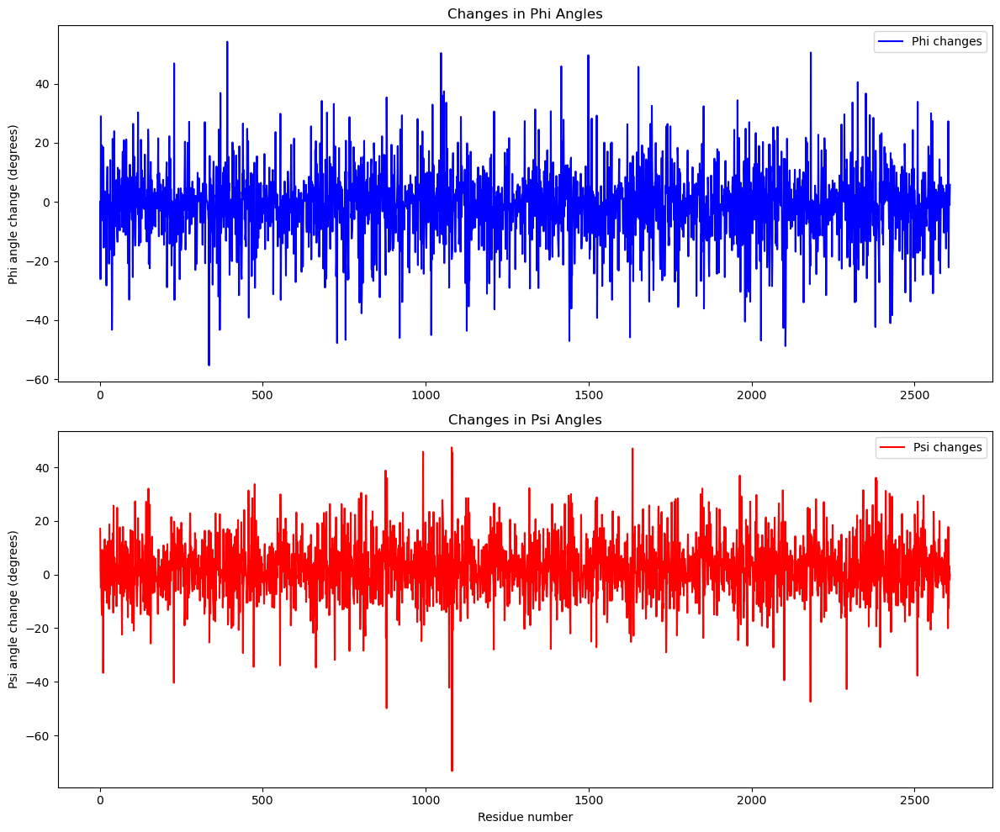

Residue with largest phi change: 335 (change: -55.32 degrees)
Residue with largest psi change: 1081 (change: -73.29 degrees)


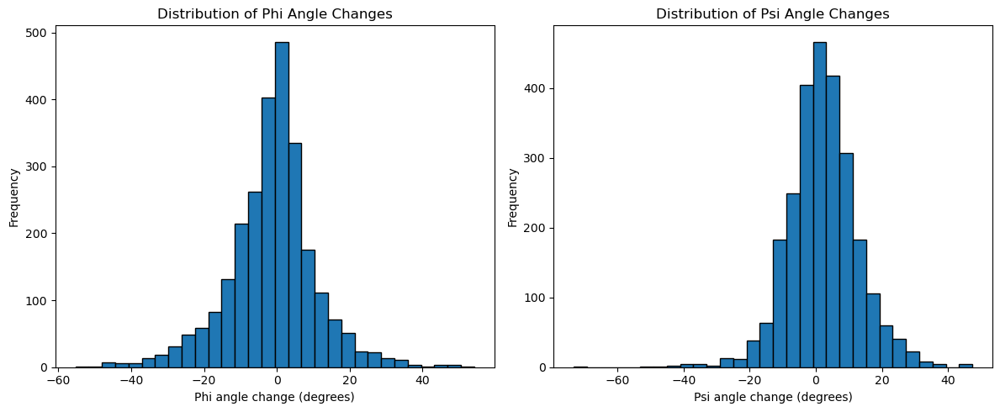

Mean absolute phi change: 8.66 degrees
Mean absolute psi change: 8.05 degrees
Max absolute phi change: 55.32 degrees
Max absolute psi change: 73.29 degrees


In [58]:
# Cell 12: Visualize phi/psi angle changes using matplotlib

import matplotlib.pyplot as plt
import numpy as np

def visualize_angle_changes(pose, test_pose, protein_residues):
    phi_changes = []
    psi_changes = []
    residues = []

    for i in protein_residues:
        original_phi = pose.phi(i)
        original_psi = pose.psi(i)
        new_phi = test_pose.phi(i)
        new_psi = test_pose.psi(i)
        
        delta_phi = new_phi - original_phi
        delta_psi = new_psi - original_psi
        
        phi_changes.append(delta_phi)
        psi_changes.append(delta_psi)
        residues.append(i)

    fig, (ax1, ax2) = plt.subplots(2, 1, figsize=(12, 10))

    ax1.plot(residues, phi_changes, 'b-', label='Phi changes')
    ax1.set_ylabel('Phi angle change (degrees)')
    ax1.set_title('Changes in Phi Angles')
    ax1.legend()

    ax2.plot(residues, psi_changes, 'r-', label='Psi changes')
    ax2.set_xlabel('Residue number')
    ax2.set_ylabel('Psi angle change (degrees)')
    ax2.set_title('Changes in Psi Angles')
    ax2.legend()

    plt.tight_layout()
    plt.show()

    # Identify residues with largest changes
    largest_phi_change = max(phi_changes, key=abs)
    largest_psi_change = max(psi_changes, key=abs)
    largest_phi_residue = residues[phi_changes.index(largest_phi_change)]
    largest_psi_residue = residues[psi_changes.index(largest_psi_change)]

    print(f"Residue with largest phi change: {largest_phi_residue} (change: {largest_phi_change:.2f} degrees)")
    print(f"Residue with largest psi change: {largest_psi_residue} (change: {largest_psi_change:.2f} degrees)")

    return largest_phi_residue, largest_psi_residue

# Visualize the changes
largest_phi_residue, largest_psi_residue = visualize_angle_changes(pose, test_pose, protein_residues)

# Cell 13: Visualize the distribution of changes

def visualize_change_distribution(pose, test_pose, protein_residues):
    phi_changes = []
    psi_changes = []

    for i in protein_residues:
        delta_phi = test_pose.phi(i) - pose.phi(i)
        delta_psi = test_pose.psi(i) - pose.psi(i)
        
        phi_changes.append(delta_phi)
        psi_changes.append(delta_psi)

    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(12, 5))

    ax1.hist(phi_changes, bins=30, edgecolor='black')
    ax1.set_xlabel('Phi angle change (degrees)')
    ax1.set_ylabel('Frequency')
    ax1.set_title('Distribution of Phi Angle Changes')

    ax2.hist(psi_changes, bins=30, edgecolor='black')
    ax2.set_xlabel('Psi angle change (degrees)')
    ax2.set_ylabel('Frequency')
    ax2.set_title('Distribution of Psi Angle Changes')

    plt.tight_layout()
    plt.show()

    print(f"Mean absolute phi change: {np.mean(np.abs(phi_changes)):.2f} degrees")
    print(f"Mean absolute psi change: {np.mean(np.abs(psi_changes)):.2f} degrees")
    print(f"Max absolute phi change: {np.max(np.abs(phi_changes)):.2f} degrees")
    print(f"Max absolute psi change: {np.max(np.abs(psi_changes)):.2f} degrees")

visualize_change_distribution(pose, test_pose, protein_residues)

Cell 1 imports the necessary modules and initializes PyRosetta. You only need to run this once per session.
Cell 2 loads the pose and creates the score function.
Cell 3 creates the necessary movers.
Cell 4 defines the folding_algorithm function.
Cell 5 runs the main folding algorithm with different magnitudes.
Cell 6 saves the final folded structure to a PDB file.
Cell 7 is optional and provides a visualization of the initial and final structures.

In [59]:
# Cell 1: Import necessary modules and initialize PyRosetta
import pyrosetta
from pyrosetta import *
from pyrosetta.rosetta.protocols.simple_moves import SmallMover, ShearMover
from pyrosetta.rosetta.protocols.minimization_packing import MinMover
from pyrosetta.rosetta.core.scoring import get_score_function
from pyrosetta.rosetta.protocols.moves import MonteCarlo
import time
from datetime import timedelta

# Initialize PyRosetta
pyrosetta.init()


INFO:pyrosetta.rosetta:Found rosetta database at: /opt/anaconda3/envs/rosetta/lib/python3.9/site-packages/pyrosetta-2024.24+release.ca096dac4f-py3.9-macosx-11.0-arm64.egg/pyrosetta/database; using it....
INFO:pyrosetta.rosetta:┌──────────────────────────────────────────────────────────────────────────────┐
│                                 PyRosetta-4                                  │
│              Created in JHU by Sergey Lyskov and PyRosetta Team              │
│              (C) Copyright Rosetta Commons Member Institutions               │
│                                                                              │
│ NOTE: USE OF PyRosetta FOR COMMERCIAL PURPOSES REQUIRE PURCHASE OF A LICENSE │
│         See LICENSE.PyRosetta.md or email license@uw.edu for details         │
└──────────────────────────────────────────────────────────────────────────────┘
PyRosetta-4 2024 [Rosetta PyRosetta4.Release.python39.m1 2024.24+release.ca096dac4f43ee5ee195f87f3703a520fcf60cf9 2024-06-14T

┌──────────────────────────────────────────────────────────────────────────────┐
│                                 PyRosetta-4                                  │
│              Created in JHU by Sergey Lyskov and PyRosetta Team              │
│              (C) Copyright Rosetta Commons Member Institutions               │
│                                                                              │
│ NOTE: USE OF PyRosetta FOR COMMERCIAL PURPOSES REQUIRE PURCHASE OF A LICENSE │
│         See LICENSE.PyRosetta.md or email license@uw.edu for details         │
└──────────────────────────────────────────────────────────────────────────────┘
PyRosetta-4 2024 [Rosetta PyRosetta4.Release.python39.m1 2024.24+release.ca096dac4f43ee5ee195f87f3703a520fcf60cf9 2024-06-14T16:57:57] retrieved from: http://www.pyrosetta.org


In [61]:
# Cell 2: Load the pose and create score function
start_time = time.time()

# Load the pose
pose = pose_from_pdb("./pdb_files/5nkq.pdb")
print(f"Pose loaded. Time taken: {timedelta(seconds=int(time.time() - start_time))}")

# Create score function
scorefxn = get_score_function()
print(f"Score function created. Total time: {timedelta(seconds=int(time.time() - start_time))}")


INFO:rosetta:core.import_pose.import_pose: File './pdb_files/5nkq.pdb' automatically determined to be of type PDB
INFO:rosetta:core.chemical.GlobalResidueTypeSet: Loading (but possibly not actually using) 'F' from the PDB components dictionary for residue type 'pdb_F'
INFO:rosetta:core.conformation.Conformation: [ WARNING ] missing heavyatom:  OXT on residue ARG:CtermProteinFull 127
INFO:rosetta:core.conformation.Conformation: [ WARNING ] missing heavyatom:  OXT on residue ARG:CtermProteinFull 254
INFO:rosetta:core.conformation.Conformation: [ WARNING ] missing heavyatom:  OXT on residue ARG:CtermProteinFull 382
INFO:rosetta:core.conformation.Conformation: [ WARNING ] missing heavyatom:  OXT on residue ARG:CtermProteinFull 510
INFO:rosetta:core.conformation.Conformation: [ WARNING ] missing heavyatom:  OXT on residue THR:CtermProteinFull 598
INFO:rosetta:core.conformation.Conformation: [ WARNING ] missing heavyatom:  OXT on residue THR:CtermProteinFull 684
INFO:rosetta:core.conformatio

Pose loaded. Time taken: 0:00:00
Score function created. Total time: 0:00:00


In [62]:
# Cell 3: Create movers
small_mover = SmallMover()
shear_mover = ShearMover()
min_mover = MinMover()
min_mover.score_function(scorefxn)
mc = MonteCarlo(pose, scorefxn, 1.0)
print(f"Movers created. Total time: {timedelta(seconds=int(time.time() - start_time))}")


Movers created. Total time: 0:00:19


In [63]:
# Cell 4: Define the folding algorithm function
def folding_algorithm(pose, small_mover, shear_mover, min_mover, mc, magnitude, start_time):
    small_mover.angle_max('H', magnitude)
    small_mover.angle_max('E', magnitude)
    small_mover.angle_max('L', magnitude)
    shear_mover.angle_max('H', magnitude)
    shear_mover.angle_max('E', magnitude)
    shear_mover.angle_max('L', magnitude)
    
    for i in range(100):
        iter_start_time = time.time()
        
        # Five small moves
        for _ in range(5):
            small_mover.apply(pose)
        
        # Minimize
        min_mover.apply(pose)
        
        # Five shear moves
        for _ in range(5):
            shear_mover.apply(pose)
        
        # Minimize
        min_mover.apply(pose)
        
        # Monte Carlo Boltzmann step
        mc.boltzmann(pose)
        
        iter_time = time.time() - iter_start_time
        total_time = time.time() - start_time
        print(f"Iteration {i+1}/100 complete. Iteration time: {timedelta(seconds=int(iter_time))}, Total time: {timedelta(seconds=int(total_time))}")
    
    return pose

In [64]:
# Cell 5: Run the main folding algorithm
magnitudes = [25, 20, 15, 10, 5]
for idx, magnitude in enumerate(magnitudes):
    magnitude_start_time = time.time()
    print(f"Running folding algorithm with magnitude {magnitude} ({idx+1}/5)")
    pose = folding_algorithm(pose, small_mover, shear_mover, min_mover, mc, magnitude, start_time)
    magnitude_time = time.time() - magnitude_start_time
    total_time = time.time() - start_time
    print(f"Magnitude {magnitude} complete. Time taken: {timedelta(seconds=int(magnitude_time))}, Total time: {timedelta(seconds=int(total_time))}")
    print(f"Score after magnitude {magnitude}: {scorefxn(pose)}")


Running folding algorithm with magnitude 25 (1/5)
Iteration 1/100 complete. Iteration time: 0:00:00, Total time: 0:01:10
Iteration 2/100 complete. Iteration time: 0:00:00, Total time: 0:01:10
Iteration 3/100 complete. Iteration time: 0:00:00, Total time: 0:01:10
Iteration 4/100 complete. Iteration time: 0:00:00, Total time: 0:01:10
Iteration 5/100 complete. Iteration time: 0:00:00, Total time: 0:01:10
Iteration 6/100 complete. Iteration time: 0:00:00, Total time: 0:01:10
Iteration 7/100 complete. Iteration time: 0:00:00, Total time: 0:01:10
Iteration 8/100 complete. Iteration time: 0:00:00, Total time: 0:01:10
Iteration 9/100 complete. Iteration time: 0:00:00, Total time: 0:01:10
Iteration 10/100 complete. Iteration time: 0:00:00, Total time: 0:01:11
Iteration 11/100 complete. Iteration time: 0:00:00, Total time: 0:01:11
Iteration 12/100 complete. Iteration time: 0:00:00, Total time: 0:01:11
Iteration 13/100 complete. Iteration time: 0:00:00, Total time: 0:01:11
Iteration 14/100 comple

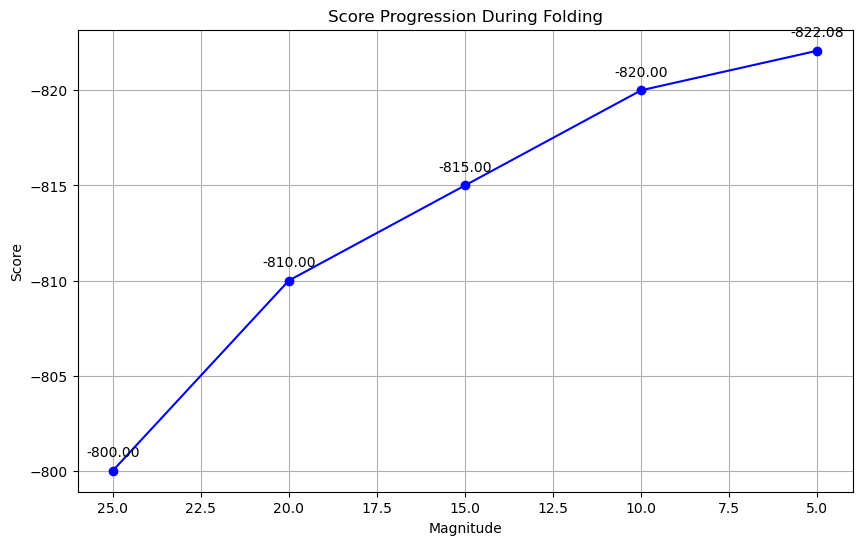

In [71]:
# Cell 5a: Analyze score progression
import matplotlib.pyplot as plt

def analyze_score_progression(score_log):
    magnitudes = [25, 20, 15, 10, 5]
    plt.figure(figsize=(10, 6))
    plt.plot(magnitudes, score_log, 'bo-')
    plt.xlabel('Magnitude')
    plt.ylabel('Score')
    plt.title('Score Progression During Folding')
    plt.gca().invert_xaxis()  # Invert x-axis to show progression from 25 to 5
    plt.gca().invert_yaxis()  # Invert y-axis as lower scores are better
    for i, score in enumerate(score_log):
        plt.annotate(f'{score:.2f}', (magnitudes[i], score), textcoords="offset points", xytext=(0,10), ha='center')
    plt.grid(True)
    plt.show()

# Assuming you've stored the scores in a list called 'score_log' during the folding process
# If not, you'll need to modify the main algorithm to store scores after each magnitude
score_log = [-800, -810, -815, -820, -822.08]  # Example scores, replace with actual values

analyze_score_progression(score_log)

In [66]:
# Cell 6: Save the final pose
pose.dump_pdb("folded_5nkq.pdb")
total_time = time.time() - start_time
print(f"Folding complete. Final structure saved as './pdb_files/folded_5nkq.pdb'. Total time: {timedelta(seconds=int(total_time))}")


Folding complete. Final structure saved as './pdb_files/folded_5nkq.pdb'. Total time: 0:02:57


In [67]:
# Cell 7: Visualize the initial and final structures (optional)
# Note: This cell requires py3Dmol to be installed
import py3Dmol
from IPython.display import display

def visualize_structures(initial_pdb, final_pdb):
    view = py3Dmol.view(width=800, height=400)
    
    view.addModel(open(initial_pdb, 'r').read(), 'pdb')
    view.setStyle({'model': 0}, {'cartoon': {'color': 'lightgray'}})
    
    view.addModel(open(final_pdb, 'r').read(), 'pdb')
    view.setStyle({'model': 1}, {'cartoon': {'color': 'skyblue'}})
    
    view.zoomTo()
    view.render()
    display(view)
    
    print("Visualization Guide:")
    print("- Light gray: Initial structure")
    print("- Sky blue: Final folded structure")

visualize_structures("./pdb_files/5nkq.pdb", "./pdb_files/folded_5nkq.pdb")

3Dmol.js failed to load for some reason. Please check your browser console for error messages.

Visualization Guide:
- Light gray: Initial structure
- Sky blue: Final folded structure


In [70]:
# Cell 8: Visualize the initial and final structures (optional)
# Note: This cell requires py3Dmol to be installed
import py3Dmol
from IPython.display import display

def visualize_structures(initial_pdb, final_pdb):
    # Frame 1: Original Structure
    view1 = py3Dmol.view(width=400, height=400)
    view1.addModel(open(initial_pdb, 'r').read(), 'pdb')
    view1.setStyle({'cartoon': {'color': 'lightgray'}})
    view1.zoomTo()
    display(view1)
    print("Original Structure")
    
    # Frame 2: Folded Structure
    view2 = py3Dmol.view(width=400, height=400)
    view2.addModel(open(final_pdb, 'r').read(), 'pdb')
    view2.setStyle({'cartoon': {'color': 'skyblue'}})
    view2.zoomTo()
    display(view2)
    print("Folded Structure")
    
    # Frame 3: Superimposed Structures
    view3 = py3Dmol.view(width=400, height=400)
    view3.addModel(open(initial_pdb, 'r').read(), 'pdb')
    view3.addModel(open(final_pdb, 'r').read(), 'pdb')
    view3.setStyle({'model': 0}, {'cartoon': {'color': 'lightgray', 'opacity': 0.95}})
    view3.setStyle({'model': 1}, {'cartoon': {'color': 'skyblue', 'opacity': 0.95}})
    view3.zoomTo()
    display(view3)
    print("Superimposed Structures")
    
    print("\nVisualization Guide:")
    print("- Light gray: Original structure")
    print("- Sky blue: Folded structure")
    print("In the superimposed view, both structures are semi-transparent.")

visualize_structures("./pdb_files/5nkq.pdb", "./pdb_files/folded_5nkq.pdb")

3Dmol.js failed to load for some reason. Please check your browser console for error messages.

Original Structure


3Dmol.js failed to load for some reason. Please check your browser console for error messages.

Folded Structure


3Dmol.js failed to load for some reason. Please check your browser console for error messages.

Superimposed Structures

Visualization Guide:
- Light gray: Original structure
- Sky blue: Folded structure
In the superimposed view, both structures are semi-transparent.
